# Brazilian E-Commerce Public Dataset by Olist 💰📢

### <u>Problem Statement</u>
E-commerce provides an easy way to sell products to a large customer base. To tailor marketing campaigns for the customers, e-commerce retailers need to know their customers well. One of the methods to know the customers is to perform customer segmentation. Customer segmentation could help the e-commerce retailers to know its customer base and find out which segment of customers it might be missing. Besides, customer segmentation could also help the e-commerce retailers to find out that the products that its customers are buying together. This may prompt the e-commerce retailers to bundle those product together as a combined offering, which may increase revenue for the retailer and make the buying process more streamlined for the customers.

### <u>Objectives</u>
* To identify top 10 and bottom 10 product categories based on the review scores.
* To determine customer satisfaction by buidling wordclouds.


### <u>Dataset</u>
🌟 Provided by Olist on <a href="https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce?datasetId=55151&sortBy=voteCount&searchQuery=rfm">Kaggle</a>. The dataset has information of orders from 2016 to 2018 made at multiple marketplaces in Brazil. 
<img src='https://i.imgur.com/HRhd2Y0.png' width='800'>

In [1]:
import warnings
warnings.filterwarnings('ignore')

# Import needed libraries
import numpy as np
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
import urllib
import seaborn as sns
sns.set_style('darkgrid')
import plotly.express as px
import plotly.offline as py
py.offline.init_notebook_mode()
from IPython.display import display, HTML

# for NLP reviews of the top/ bottom 10 product categories 
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
import re, nltk
from nltk import word_tokenize
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

In [2]:
# load dataset
customer_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_customers_dataset.csv")
order_item_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_order_items_dataset.csv")
order_pyt_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_order_payments_dataset.csv")
order_review_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_order_reviews_dataset.csv")
order_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_orders_dataset.csv")
product_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_products_dataset.csv")
seller_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/olist_sellers_dataset.csv")
product_cat_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/product_category_name_translation.csv")

In [3]:
order_geolocation_df = pd.read_csv(r"C:\Users\NG POOI LING\Desktop\Data Science\0. PROJECTS\4. Brazilian E-Commerce Public Dataset\Datasets\olist_geolocation_dataset.csv")

## Data Cleaning & Preprocessing

In [4]:
# Removing some outliers
#Brazils most Northern spot is at 5 deg 16′ 27.8″ N latitude.;
order_geolocation_df = order_geolocation_df[order_geolocation_df.geolocation_lat <= 5.27438888]
#it’s most Western spot is at 73 deg, 58′ 58.19″W Long.
order_geolocation_df = order_geolocation_df[order_geolocation_df.geolocation_lng >= -73.98283055]
#It’s most southern spot is at 33 deg, 45′ 04.21″ S Latitude.
order_geolocation_df = order_geolocation_df[order_geolocation_df.geolocation_lat >= -33.75116944]
#It’s most Eastern spot is 34 deg, 47′ 35.33″ W Long.
order_geolocation_df = order_geolocation_df[order_geolocation_df.geolocation_lng <=  -34.79314722]

In [5]:
# remove zip codes that have two or more states
state_zip = order_geolocation_df.groupby(['geolocation_zip_code_prefix','geolocation_state']).size().reset_index(name='count').drop_duplicates(subset = 'geolocation_zip_code_prefix')

# use the median value of the latitude and longitude of each zip code
order_geolocation_df = order_geolocation_df.groupby(['geolocation_zip_code_prefix','geolocation_city','geolocation_state'])[['geolocation_lat','geolocation_lng']].median().reset_index()
order_geolocation_df = order_geolocation_df.merge(state_zip,on=['geolocation_zip_code_prefix','geolocation_state'],how='inner')
order_geolocation_df = order_geolocation_df.drop(['count'],axis=1)

# save cleaned dataframe to csv
# order_geolocation_df.to_csv('cleaned_geolocation.csv',index=False)

In [6]:
# create new customer-related dataframe to visualize customers' locations
customer_geo = customer_df.merge(order_geolocation_df,  left_on='customer_zip_code_prefix', 
                                 right_on='geolocation_zip_code_prefix', how='inner')
customer_geo = customer_geo.drop(['customer_unique_id','geolocation_zip_code_prefix','geolocation_city','geolocation_state'],
                                 axis=1)

In [7]:
# create new seller-related dataframe to visualize sellers' locations
seller_geo = seller_df.merge(order_geolocation_df,  left_on='seller_zip_code_prefix', 
                             right_on='geolocation_zip_code_prefix', how='inner')
seller_geo = seller_geo.drop(['geolocation_zip_code_prefix','geolocation_city','geolocation_state'],
                             axis=1)

In [8]:
# remove rows where the order_status is NOT equal to 'delivered' 
status = ['canceled','shipped','unavailable','invoiced','processing','created','approved']
order_df = order_df[~order_df['order_status'].isin(status)]

In [9]:
order_df.isnull().sum()

order_id                          0
customer_id                       0
order_status                      0
order_purchase_timestamp          0
order_approved_at                14
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
dtype: int64

In [10]:
# remove rows with null values
order_df = order_df[~order_df['order_approved_at'].isnull()]
order_df = order_df[~order_df['order_delivered_customer_date'].isnull()]
order_df = order_df[~order_df['order_delivered_carrier_date'].isnull()]

columns_timestamp = ['order_purchase_timestamp','order_approved_at', 'order_delivered_carrier_date', 
                     'order_delivered_customer_date', 'order_estimated_delivery_date']

for column in columns_timestamp:
    order_df[column] = pd.to_datetime(order_df[column])   
    
# calculate the difference between the estimated delivery date and date the customer received the items
order_df['diff_delivery_days'] = (order_df['order_estimated_delivery_date'] - order_df['order_delivered_customer_date']).dt.days
order_df['delivery_lead'] = (order_df['order_delivered_carrier_date'] - order_df['order_approved_at']).dt.days

I uploaded the olist_order_reviews_dataset to my Google drive and opened the file with Google Spreadsheet. Then, I used functions to remove line breaks and translate the review comments from Portugese into English `=SUBSTITUTE(GOOGLETRANSLATE(text,"pt","en"),CHAR(10),"")`. After that, I saved the file with translated comments in the format of csv.  This `order_review_df` dataframe would be combined with other cleaned dataframes in order to preserve most of the data. On the other hands, the `translated_review_df` dataframe (all of its null comments removed) would be used when we need to perform sentimetal analysis on the reviews and create wordclouds. 

In [11]:
# load review dataset that contains the english translation
translated_review_df = pd.read_csv("https://raw.githubusercontent.com/jadanpl/Brazilian-E-Commerce-Olist/main/Datasets/cleaned_translated_reviews.csv")

In [12]:
translated_review_df = translated_review_df[~translated_review_df['review_comment_en'].isin(['#VALUE!'])]
translated_review_df = translated_review_df.drop(['review_comment_message','review_creation_date','review_answer_timestamp','review_comment_title'], axis=1)

# save cleaned dataframe to csv
# translated_review_df.to_csv('cleaned_translated_reviews.csv',index=False)

In [13]:
product_df = product_df.merge(product_cat_df, on='product_category_name',how='inner')
product_df.replace({'home_appliances_2': 'home_appliances','home_confort':'home_comfort','home_comfort_2':'home_comfort'}, 
                   inplace=True)
product_df = product_df.drop(['product_category_name'],axis=1)

# remove unnecessary columns
product_df = product_df.drop(['product_name_lenght', 'product_description_lenght', 'product_photos_qty'], axis=1)

# calculate the product volume
product_df['product_volume_cubic_cm'] = product_df['product_length_cm']*product_df['product_height_cm']*product_df['product_width_cm']

# rename columns
product_df.rename(columns={'product_category_name_english':'product_category'},inplace=True)

# # impute missing values 
product_df['product_weight_g'] = product_df['product_weight_g'].fillna(product_df['product_weight_g'].median())
product_df['product_length_cm'] = product_df['product_length_cm'].fillna(product_df['product_length_cm'].median())
product_df['product_height_cm'] = product_df['product_height_cm'].fillna(product_df['product_height_cm'].median())
product_df['product_width_cm'] = product_df['product_width_cm'].fillna(product_df['product_width_cm'].median())
product_df['product_volume_cubic_cm'] = product_df['product_volume_cubic_cm'].fillna(product_df['product_volume_cubic_cm'].median())

In [14]:
comp_df = order_df.copy()
comp_df = comp_df.merge(customer_df, on='customer_id',how='inner')
comp_df = comp_df.merge(order_item_df, on='order_id', how='inner')
comp_df = comp_df.merge(order_pyt_df, on='order_id', how='inner')
comp_df = comp_df.merge(order_review_df, on='order_id', how='inner')
comp_df = comp_df.merge(product_df, on='product_id', how='inner')
comp_df = comp_df.merge(seller_df, on='seller_id',how='inner')

# remove unnecessary columns
comp_df = comp_df.drop(['product_id', 'customer_zip_code_prefix', 'seller_zip_code_prefix','review_comment_message','review_comment_title'], axis=1)

In [15]:
comp_df.isnull().sum()

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
diff_delivery_days               0
delivery_lead                    0
customer_unique_id               0
customer_city                    0
customer_state                   0
order_item_id                    0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
payment_sequential               0
payment_type                     0
payment_installments             0
payment_value                    0
review_id                        0
review_score                     0
review_creation_date             0
review_answer_timestamp          0
product_weight_g                 0
product_length_cm                0
product_height_cm   

In [16]:
print('Number of duplicated review_id: ', len(comp_df[comp_df.duplicated(subset=['review_id'])==True]))
print('Number of duplicated order_id: ', len(comp_df[comp_df.duplicated(subset='order_id')==True]))

Number of duplicated review_id:  18897
Number of duplicated order_id:  18721


In [17]:
review_order = comp_df.groupby('review_id').agg({'order_id':'nunique'}).sort_values('order_id',ascending=False).reset_index()
review_more_order = review_order[review_order['order_id']>1]
print(len(review_more_order['review_id']),"reviews are associated with more than 1 order.")
# review_order[review_order['order_id']>1]

681 reviews are associated with more than 1 order.


In [18]:
order_review = comp_df.groupby('order_id').agg({'review_id':'nunique'}).sort_values('review_id',ascending=False).reset_index()
order_more_review = order_review[order_review['review_id']>1]
print(len(order_more_review['order_id']),"orders are associated with more than 1 review.")
# order_review[order_review['review_id']>1]

517 orders are associated with more than 1 review.


In [19]:
comp_df = comp_df[~comp_df['review_id'].isin(review_more_order['review_id'].to_list())]
comp_df = comp_df[~comp_df['order_id'].isin(order_more_review['order_id'].to_list())]

In [20]:
comp_df.shape

(110885, 34)

For simplicity, those reviews asssociated with more than one order and those orders associated with more than one review are removed. There are still duplicated `review_id` and `order_id` in the dataset, but now each `review_id` is associated with one `order_id` and one `review_comment_en`. These `review_id` and `order_id` are duplicated because they are related to different `order_item_id`, `seller_id` and `product_category`. 

In [21]:
with pd.option_context('display.max_columns', None):
    display(comp_df[comp_df['review_id']=='603ddc65c5b8913a5916447af9bf358a'])

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,diff_delivery_days,delivery_lead,customer_unique_id,customer_city,customer_state,order_item_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_creation_date,review_answer_timestamp,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category,product_volume_cubic_cm,seller_city,seller_state
20023,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,1,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
20024,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,3,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
20025,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,4,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
20026,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,6,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
20027,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,10,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
20028,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,11,1025f0e2d44d7041d6cf58b6550e0bfa,2018-03-15 10:55:56,84.0,29.44,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,4100.0,30.0,35.0,30.0,furniture_decor,31500.0,sao paulo,SP
37178,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70f3dc31c23319ae1029eac77f,alto paraiso de goias,GO,2,1f50f920176fa81dab994f9023523100,2018-03-15 10:55:56,53.9,19.63,1,credit_card,2,1048.31,603ddc65c5b8913a5916447af9bf358a,3,2018-03-22 00:00:00,2018-03-23 00:22:21,1500.0,30.0,22.0,30.0,garden_tools,19800.0,sao jose do rio preto,SP
37179,7f2c22c54cbae55091a09a9653fd2b8a,f4c13379ddd0ed4f4fc1c0b49c2c5e51,delivered,2018-03-10 10:53:51,2018-03-11 10:55:56,2018-03-14 17:55:24,2018-03-21 17:46:34,2018-04-04,13,3,fe2b2f70

In [22]:
comp_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110885 entries, 0 to 113186
Data columns (total 34 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       110885 non-null  object        
 1   customer_id                    110885 non-null  object        
 2   order_status                   110885 non-null  object        
 3   order_purchase_timestamp       110885 non-null  datetime64[ns]
 4   order_approved_at              110885 non-null  datetime64[ns]
 5   order_delivered_carrier_date   110885 non-null  datetime64[ns]
 6   order_delivered_customer_date  110885 non-null  datetime64[ns]
 7   order_estimated_delivery_date  110885 non-null  datetime64[ns]
 8   diff_delivery_days             110885 non-null  int64         
 9   delivery_lead                  110885 non-null  int64         
 10  customer_unique_id             110885 non-null  object        
 11  

In [23]:
with pd.option_context('display.max_columns', None):
    display(comp_df.describe(include=[int, float,object]))

,order_id,customer_id,order_status,diff_delivery_days,delivery_lead,customer_unique_id,customer_city,customer_state,order_item_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_creation_date,review_answer_timestamp,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category,product_volume_cubic_cm,seller_city,seller_state
count,110885,110885,110885,110885.000000,110885.000000,110885,110885,110885,110885.000000,110885,110885,110885.000000,110885.000000,110885.000000,110885,110885.000000,110885.000000,110885,110885.000000,110885,110885,110885.000000,110885.000000,110885.000000,110885.000000,110885,110885.000000,110885,110885
unique,93164,93164,1,NaN,NaN,90825,4063,27,NaN,2899,88336,NaN,NaN,NaN,4,NaN,NaN,93164,NaN,626,93020,NaN,NaN,NaN,NaN,69,NaN,585,22
top,895ab968e7bb0d5659d16cd74cd1650c,270c23a11d024a44c896d1894b261a83,delivered,NaN,NaN,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,NaN,6560211a19b47992c3666cc44a7e94c0,2017-08-14 20:43:31,NaN,NaN,NaN,credit_card,NaN,NaN,eef5dbca8d37dfce6db7d7b16dd0525e,NaN,2018-05-22 00:00:00,2017-08-17 22:17:55,NaN,NaN,NaN,NaN,bed_bath_table,NaN,sao paulo,SP
freq,63,63,110885,NaN,NaN,75,17456,46838,NaN,2045,63,NaN,NaN,NaN,81848,NaN,NaN,63,NaN,518,63,NaN,NaN,NaN,NaN,11170,NaN,27743,79005
mean,NaN,NaN,NaN,11.070379,2.324814,NaN,NaN,NaN,1.193660,NaN,NaN,120.470339,20.038706,1.089733,NaN,2.930414,172.023355,NaN,4.087514,NaN,NaN,2111.901601,30.250719,16.631402,23.070911,NaN,15328.744501,NaN,NaN
std,NaN,NaN,NaN,10.081913,3.548057,NaN,NaN,NaN,0.684353,NaN,NaN,182.428107,15.770771,0.683350,NaN,2.769048,265.868622,NaN,1.341794,NaN,NaN,3769.444423,16.160135,13.456136,11.730212,NaN,23448.289904,NaN,NaN
min,NaN,NaN,NaN,-189.000000,-172.000000,NaN,NaN,NaN,1.000000,NaN,NaN,0.850000,0.000000,1.000000,NaN,0.000000,0.000000,NaN,1.000000,NaN,NaN,0.000000,7.000000,2.000000,6.000000,NaN,168.000000,NaN,NaN
25%,NaN,NaN,NaN,6.000000,0.000000,NaN,NaN,NaN,1.000000,NaN,NaN,39.900000,13.080000,1.000000,NaN,1.000000,61.000000,NaN,4.000000,NaN,NaN,300.000000,18.000000,8.000000,15.000000,NaN,2856.000000,NaN,NaN
50%,NaN,NaN,NaN,12.000000,1.000000,NaN,NaN,NaN,1.000000,NaN,NaN,74.900000,16.320000,1.000000,NaN,2.000000,108.200000,NaN,5.000000,NaN,NaN,700.000000,25.000000,13.000000,20.000000,NaN,6650.000000,NaN,NaN
75%,NaN,NaN,NaN,16.000000,3.000000,NaN,NaN,NaN,1.000000,NaN,NaN,134.900000,21.220000,1.000000,NaN,4.000000,189.350000,NaN,5.000000,NaN,NaN,1800.000000,38.000000,20.000000,30.000000,NaN,18576.000000,NaN,NaN


## Explanatory Data Analysis

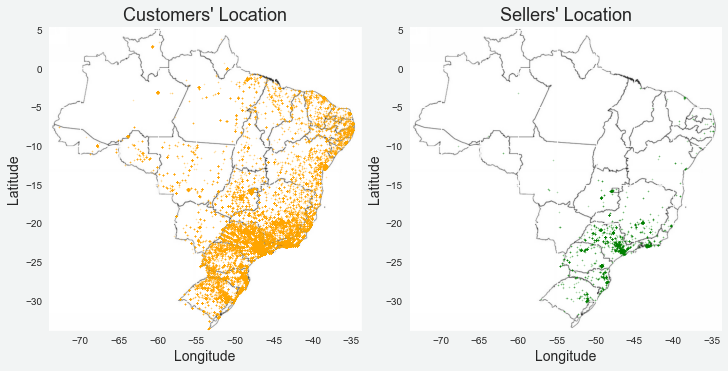

In [24]:
fig, ax = plt.subplots(1,2,figsize=(16,12), facecolor='#F2F4F4',constrained_layout=True)
brazil = mpimg.imread(urllib.request.urlopen('https://i.pinimg.com/originals/3a/0c/e1/3a0ce18b3c842748c255bc0aa445ad41.jpg'),'jpg')

cus_geo = customer_geo.plot(kind="scatter", x="geolocation_lng", y="geolocation_lat", 
                            figsize=(10,8), alpha=0.3, s=0.3,c='orange',ax=ax[0])
cus_geo.imshow(brazil, extent=[-73.98283055, -33.8,-33.75116944,5.4])
cus_geo.set_ylabel("Latitude", fontsize=14)
cus_geo.set_xlabel("Longitude", fontsize=14)
cus_geo.set_title("Customers' Location", fontsize=18)

sel_geo = seller_geo.plot(kind="scatter", x="geolocation_lng", y="geolocation_lat", 
                          figsize=(10,8), alpha=0.3, s=0.3,c='green',ax=ax[1])
sel_geo.imshow(brazil, extent=[-73.98283055, -33.8,-33.75116944,5.4])
sel_geo.set_ylabel("Latitude", fontsize=14)
sel_geo.set_xlabel("Longitude", fontsize=14)
sel_geo.set_title("Sellers' Location", fontsize=18);

In [25]:
print('Earlist Purchase Date: ', comp_df['order_purchase_timestamp'].min())
print('Latest Purchase Date: ', comp_df['order_purchase_timestamp'].max())

Earlist Purchase Date:  2016-10-03 09:44:50
Latest Purchase Date:  2018-08-29 15:00:37


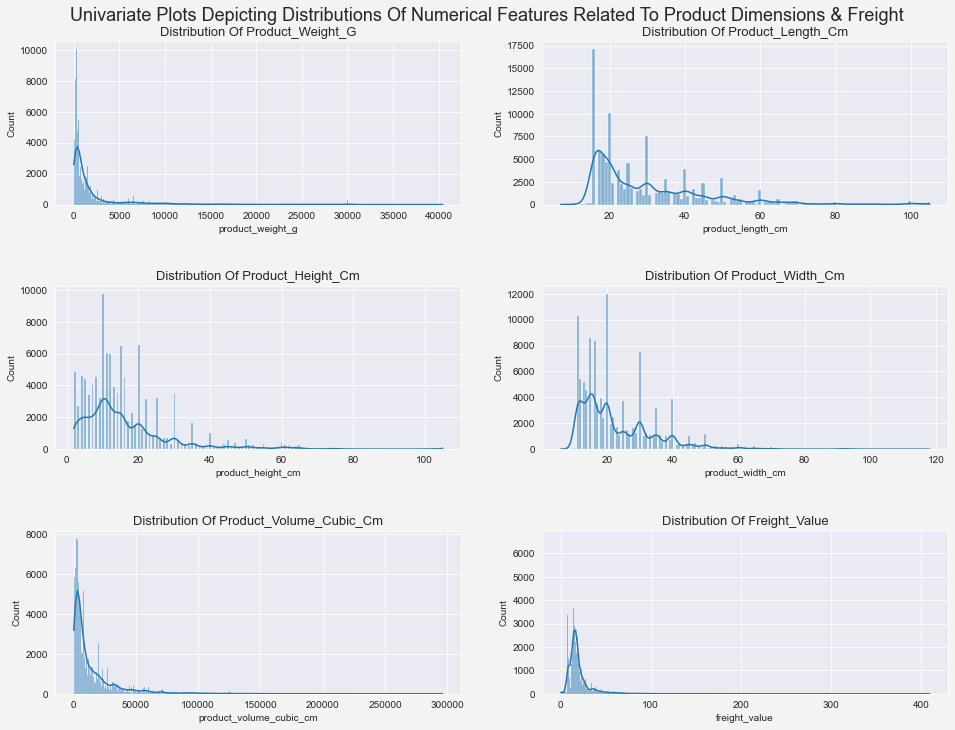

In [26]:
product_dimension_cols = ['product_weight_g','product_length_cm','product_height_cm','product_width_cm','product_volume_cubic_cm','freight_value']

fig, ax = plt.subplots(figsize=(16,12), facecolor='#F2F4F4')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.5)
count=1
for i in product_dimension_cols:
    plt.subplot(3,2,count)
    h = sns.histplot(x=i, kde=True,data=comp_df)
    h.set_title(('distribution of ' + i).title(), fontsize=13)
    count+=1
    
fig.suptitle(('Univariate plots depicting distributions of numerical features related to product dimensions & freight').title(), 
             x=0.5, y=0.92, fontsize=18);

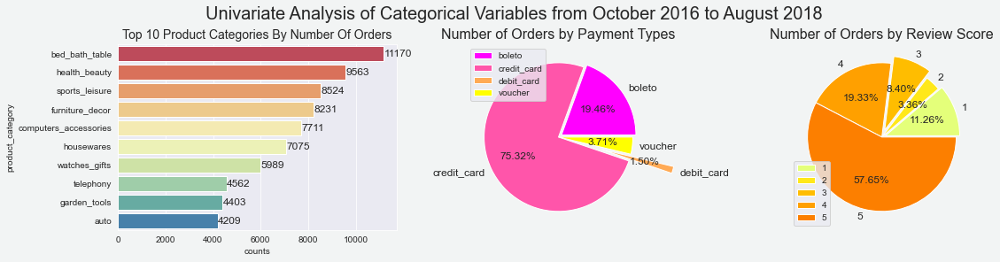

In [27]:
fig, ax = plt.subplots(1,3,figsize=(16,4), facecolor='#F2F4F4',constrained_layout=True)

top10_product_cat = comp_df['product_category'].value_counts().head(10).rename_axis('product_category').reset_index(name='counts')
a = sns.barplot(x=top10_product_cat['counts'],y=top10_product_cat['product_category'],palette='Spectral',ax=ax[0])
a.bar_label(a.containers[0], fontsize=12)
a.set_title(('top 10 product categories by number of orders').title(), fontsize=14)

d = comp_df.groupby('payment_type').agg({'order_id':'nunique'})
d.plot.pie(y='order_id', autopct='%1.2f%%', ylabel='',
           fontsize=12, explode=(0.05,0,0.6,0), cmap='spring',ax=ax[1])
ax[1].set_title('Number of Orders by Payment Types',fontsize=16)

e = comp_df.groupby('review_score').agg({'order_id':'count'})
e.plot.pie(y='order_id', autopct='%1.2f%%', ylabel='',
           fontsize=12, explode=(0.05,0,0.1,0,0), cmap='Wistia',ax=ax[2])
ax[2].set_title('Number of Orders by Review Score',fontsize=16)

plt.suptitle('Univariate Analysis of Categorical Variables from October 2016 to August 2018',fontsize=20);

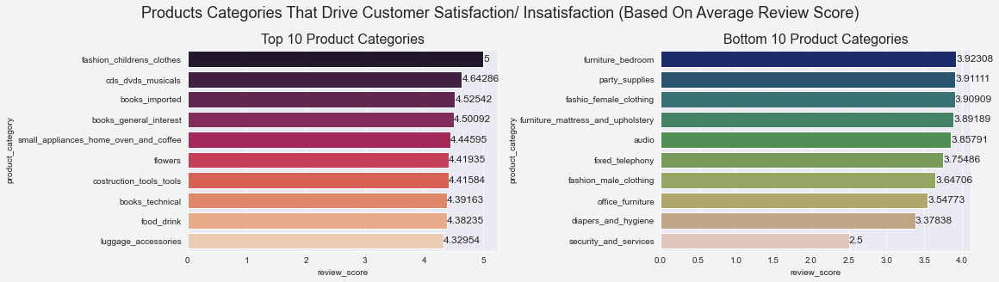

In [28]:
fig, ax = plt.subplots(1,2,figsize=(16,4), facecolor='#F2F4F4',constrained_layout=True)

# top 10 product category based on average review_score
top10_cat = comp_df.groupby('product_category').agg({'review_score':'mean','order_id':'count'}).reset_index().sort_values('review_score', ascending=False).head(10)
g = sns.barplot(y=top10_cat['product_category'], x=top10_cat['review_score'],palette='rocket',ax=ax[0])
g.bar_label(g.containers[0], fontsize=12)
g.set_title(("top 10 product categories").title(), fontsize=16)

# bottom 10 product category based on average review_score
bottom10_cat = comp_df.groupby('product_category').agg({'review_score':'mean','order_id':'count'}).reset_index().sort_values('review_score', ascending=False).tail(10)
f = sns.barplot(y=bottom10_cat['product_category'], x=bottom10_cat['review_score'],palette='gist_earth',ax=ax[1])
f.bar_label(f.containers[0], fontsize=12)
f.set_title(("bottom 10 product categories").title(), fontsize=16)

fig.suptitle(('products categories that drive customer satisfaction/ insatisfaction (based on average review score)').title(), 
             x=0.5, y=1.1, fontsize=18);

We need to <u>transform</u> the reviews data by: 
* Removing stop words, 
* Using the regular expression module to accept only letters, 
* Tokenizing/ separating the text by word or by sentencethe text, and 
* Making all the words lower case for consistency.

In [29]:
review_product_df = order_df.copy()
review_product_df = review_product_df.merge(customer_df, on='customer_id',how='inner')
review_product_df = review_product_df.merge(order_item_df, on='order_id', how='inner')
review_product_df = review_product_df.merge(translated_review_df, on='order_id', how='inner')
review_product_df = review_product_df.merge(product_df, on='product_id', how='inner')

In [30]:
top10_list = top10_cat['product_category'].tolist()
bottom10_list = bottom10_cat['product_category'].tolist()

In [31]:
# filter generic & insignificant stopwords such as articles, pronouns, prepositions, and conjunctions 
stop_words = set(stopwords.words('english'))

# Lemmatizing
wordnet = WordNetLemmatizer()

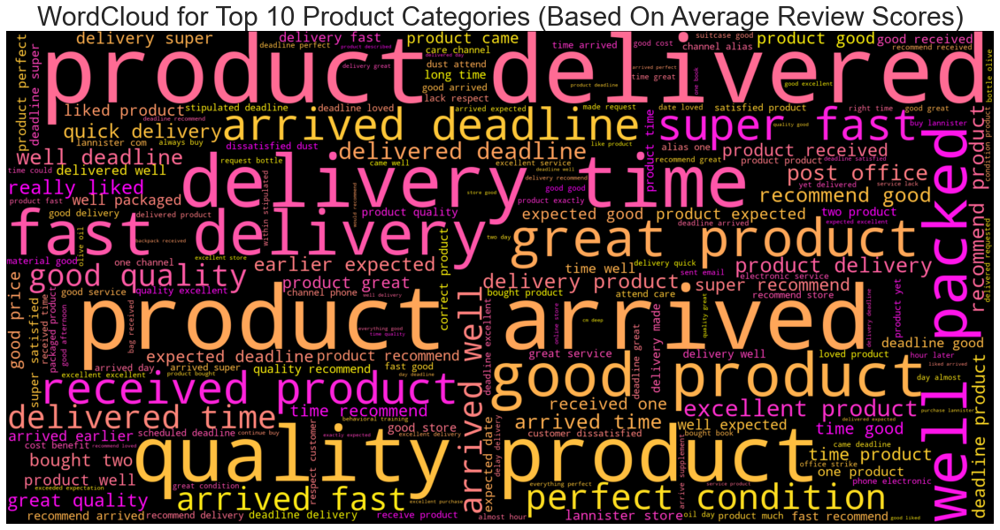

In [32]:
# analyse the reviews for top 10 categories
top10_comments = []
top10_df = review_product_df[review_product_df['product_category'].isin(top10_list)]
for words in top10_df['review_comment_en']:
    letters = re.sub("[^A-Za-z]", " ",words).lower()
    tokens = nltk.word_tokenize(letters) # tokenize the sentences
    lemmatized_words=[wordnet.lemmatize(word) for word in tokens if word not in stop_words]
    top10_comments.append(' '.join(lemmatized_words))

top10_unique = (" ").join(top10_comments) # create string or bytes-like object    
words_top10 = top10_unique.split()

# TFIDF: bigram
bigramslist_top10 = list(nltk.bigrams(words_top10))
bigram_top10 = [' '.join(top) for top in bigramslist_top10]
vectorizer = TfidfVectorizer(use_idf=True, ngram_range=(2,2))
X = vectorizer.fit_transform(bigram_top10)
sum_words = X.sum(axis=0) 
words_freq_top10 = [(word, sum_words[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
words_freq_top10 = sorted(words_freq_top10, key = lambda x: x[1], reverse=True)  
words_dict = dict(words_freq_top10)

# Using wordcloud to visualize the comments
wordcloud_pos = WordCloud(width = 2000, height = 1000, background_color='black', colormap='spring').generate_from_frequencies(words_dict)
plt.figure(figsize=(20,12))
plt.imshow(wordcloud_pos, interpolation='bilinear')
plt.axis("off")
plt.title('WordCloud for Top 10 Product Categories (Based On Average Review Scores)', fontsize=30);

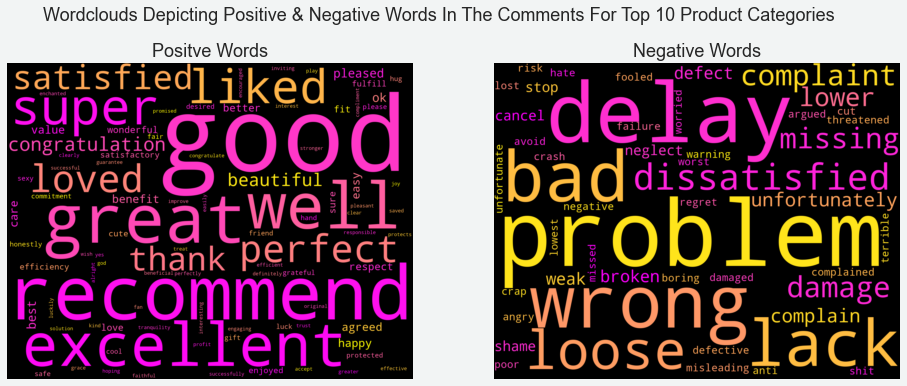

In [33]:
# initialize VADER
sid = SentimentIntensityAnalyzer()
top10_pos_words=[]
top10_neu_words=[]
top10_neg_words=[]
for word in words_top10:
    if (sid.polarity_scores(word)['compound']) >= 0.25:
        top10_pos_words.append(word)
    elif (sid.polarity_scores(word)['compound']) <= -0.25:
        top10_neg_words.append(word)
    else:
        top10_neu_words.append(word)    

top10_pos = " ".join ([w for w in top10_pos_words])
top10_neg = " ".join ([w for w in top10_neg_words])

top10_comment_df = pd.DataFrame({'Categories': {0: 'Positive', 1: 'Negative'}, 
                                 'Words': {0: top10_pos, 1: top10_neg}})

fig, ax = plt.subplots(figsize=(16,12), facecolor='#F2F4F4')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
count=1
for i in range(2):
    wc = WordCloud(background_color='black', width=1800, height=1400,colormap='spring',collocations = False).generate(text=top10_comment_df["Words"][i])   
    plt.subplot(1, 2, count)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    if i==0:
        plt.title("Positve Words", fontsize=18)
    else:
        plt.title("Negative Words", fontsize=18)
    count+=1
    i+=1    
    
fig.suptitle(('wordclouds depicting positive & negative words in the comments for top 10 product categories').title(), 
             x=0.5, y=0.75, fontsize=18);

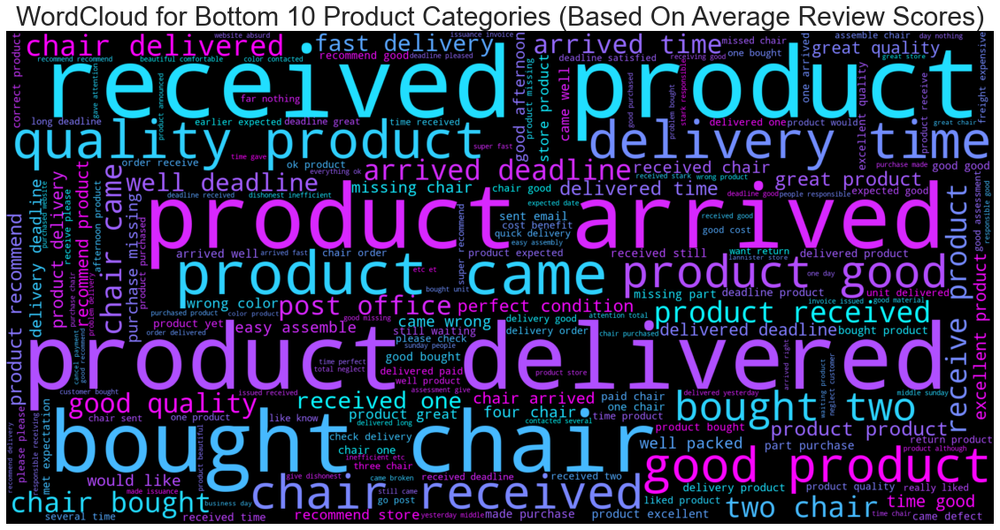

In [34]:
# analyse the reviews for bottom 10 categories
bottom10_comments = []
bottom10_df = review_product_df[review_product_df['product_category'].isin(bottom10_list)]
for words in bottom10_df['review_comment_en']:
    letters = re.sub("[^A-Za-z]", " ",words)
    tokens = nltk.word_tokenize(letters) # tokenize the sentences
    lower_case = [l.lower() for l in tokens] #convert all letters to lower case
    filtered_result = list(filter(lambda l: l not in stop_words,lower_case)) # remove stopwords from the comments
    lemmatized_words=[wordnet.lemmatize(word) for word in filtered_result]
    bottom10_comments.append(' '.join(lemmatized_words))

bottom10_unique=(" ").join(bottom10_comments) # create string or bytes-like object
words_bottom10 = bottom10_unique.split()

# TFIDF: bigram
bigramslist_bottom10 = list(nltk.bigrams(words_bottom10))
bigram_bottom10 = [' '.join(top) for top in bigramslist_bottom10]
vectorizer_bottom10 = TfidfVectorizer(use_idf=True, ngram_range=(2,2))
Z = vectorizer.fit_transform(bigram_bottom10)
sum_words_bottom10 = Z.sum(axis=0) 
words_freq_bottom10 = [(word, sum_words_bottom10[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
words_freq_bottom10 = sorted(words_freq_bottom10, key = lambda x: x[1], reverse=True)  
words_dict_bottom10 = dict(words_freq_bottom10)

# Using wordcloud to visualize the comments
wordcloud = WordCloud(width = 2000, height = 1000, background_color='black',colormap='cool').generate_from_frequencies(words_dict_bottom10)
plt.figure(figsize=(20,12))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title('WordCloud for Bottom 10 Product Categories (Based On Average Review Scores)', fontsize=30);

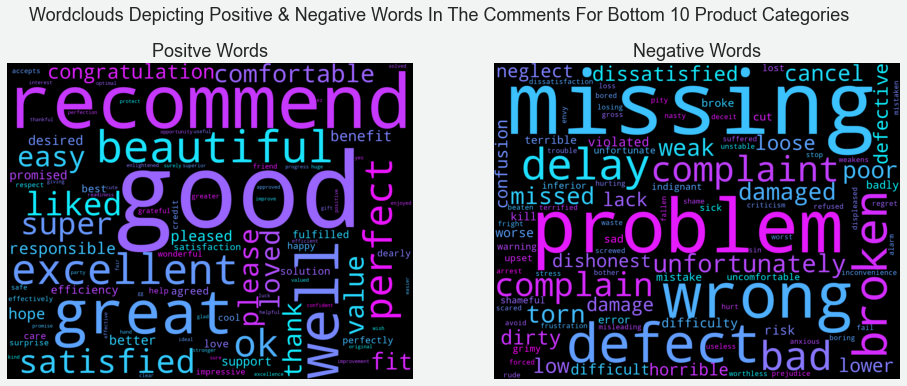

In [35]:
# initialize VADER
sid = SentimentIntensityAnalyzer()
bottom10_pos_words=[]
bottom10_neu_words=[]
bottom10_neg_words=[]
for word in words_bottom10:
    if (sid.polarity_scores(word)['compound']) >= 0.25:
        bottom10_pos_words.append(word)
    elif (sid.polarity_scores(word)['compound']) <= -0.25:
        bottom10_neg_words.append(word)
    else:
        bottom10_neu_words.append(word)    

bottom10_pos = " ".join ([w for w in bottom10_pos_words])
bottom10_neg = " ".join ([w for w in bottom10_neg_words])

bottom10_comment_df = pd.DataFrame({'Categories': {0: 'Positive', 1: 'Negative'}, 
                          'Words': {0: bottom10_pos, 1: bottom10_neg}})

fig, ax = plt.subplots(figsize=(16,12), facecolor='#F2F4F4')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.2, hspace=0.2)
count=1
for i in range(2):
    wc = WordCloud(background_color='black', width=1800, height=1400,colormap='cool', collocations = False).generate(text=bottom10_comment_df["Words"][i])   
    plt.subplot(1, 2, count)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    if i==0:
        plt.title("Positve Words", fontsize=18)
    else:
        plt.title("Negative Words", fontsize=18)
    count+=1
    i+=1    
    
fig.suptitle(('wordclouds depicting positive & negative words in the comments for bottom 10 product categories').title(), 
             x=0.5, y=0.75, fontsize=18);

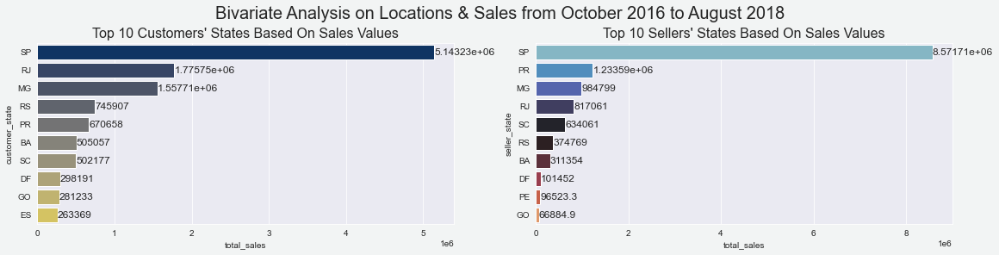

In [36]:
fig, ax = plt.subplots(1,2,figsize=(16,4), facecolor='#F2F4F4',constrained_layout=True)

top10_customer_state = comp_df.groupby('customer_state').agg({'price':'sum'}).sort_values(by='price',ascending=False).head(10).reset_index()
top10_customer_state.rename(columns={'price':'total_sales'},inplace=True)
b = sns.barplot(y=top10_customer_state['customer_state'], x=top10_customer_state['total_sales'],palette='cividis',ax=ax[0])
b.bar_label(b.containers[0], fontsize=12)
b.set_title(("top 10 customers' states based on sales values").title(), fontsize=16);

top10_seller_state = comp_df.groupby('seller_state').agg({'price':'sum'}).sort_values(by='price',ascending=False).head(10).reset_index()
top10_seller_state.rename(columns={'price':'total_sales'},inplace=True)
c = sns.barplot(y=top10_seller_state['seller_state'], x=top10_seller_state['total_sales'], palette='icefire',ax=ax[1])
c.bar_label(c.containers[0], fontsize=12)
c.set_title(("top 10 sellers' states based on sales values").title(), fontsize=16);

plt.suptitle('Bivariate Analysis on Locations & Sales from October 2016 to August 2018',fontsize=20);

In [37]:
k = px.box(x=comp_df['seller_state'], y=np.log(comp_df['price']))
k.update_layout(title="Seller State vs Price",
                xaxis_title="Seller State",
                yaxis_title="Price")
k.show()

In [38]:
comp_df['source_destination']=comp_df['customer_state']+'-'+comp_df['seller_state']
freq20_source_dest = comp_df.groupby(['source_destination']).agg({'source_destination':'count','freight_value':'median'}).rename(columns={'source_destination':'count'}).sort_values('count',ascending=False).head(20).reset_index()
top20_sd = freq20_source_dest['source_destination'].to_list()
top20_source_destination = comp_df[comp_df['source_destination'].isin(top20_sd)]

m = px.box(x=top20_source_destination['source_destination'], 
           y=np.log(top20_source_destination['freight_value']),
           color_discrete_sequence=['green'])
m.update_layout(title="Frequent Locations (From Source State to Destination State) vs Freight",
                xaxis_title="Source_Destination",
                yaxis_title="Freight")
m.show()

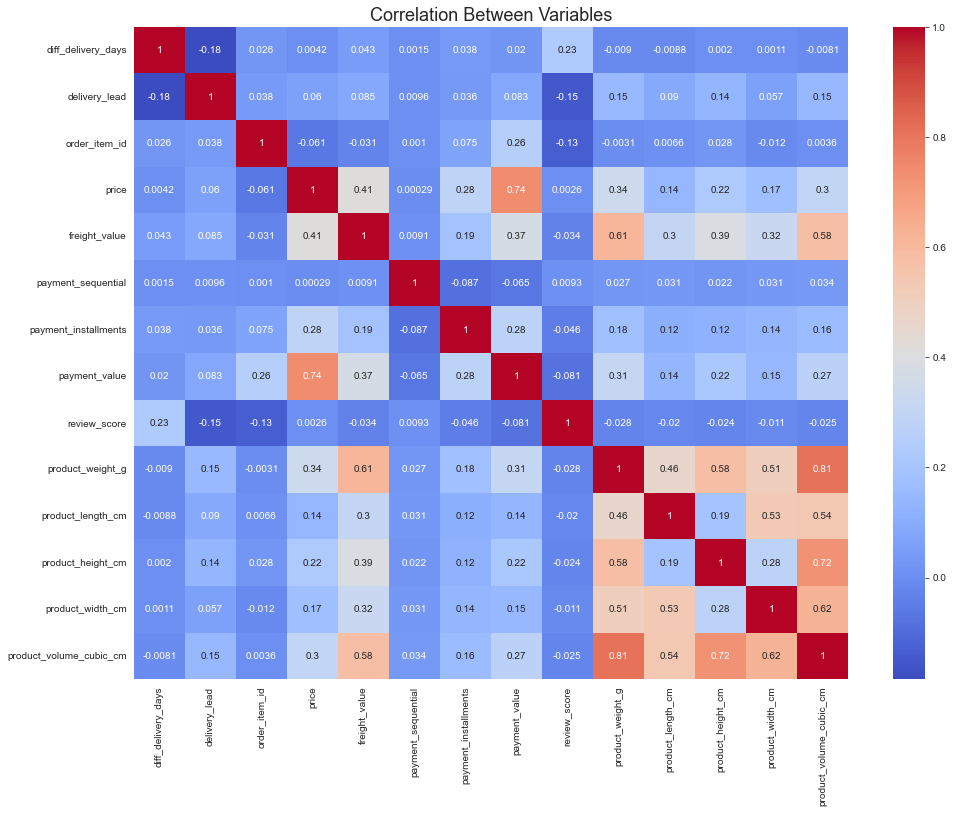

In [39]:
plt.figure(figsize=(16,12))
sns.heatmap(comp_df.corr(),annot=True,fmt='.2g',cmap='coolwarm')
plt.title('Correlation Between Variables',fontsize=18);

# Summary
1. The customers and sellers of Olist are mainly distributed in the southeast and south of the Brazil.
2. More than 50% of the items is rated as 5. Based on the wordclouds that display the negative words, the reasons that led to low review scores could be low quality (wrong/ torn/ broken/ dirty/ missing) items, delayed delivery, and others. 
3. Based on the visualization that displays the frequent locations (from the source city to ), the range for median of the freight values is between 2.32 and 3.29. From the heatmap plotted, the freight value is positively correlated with product weight and product volume. 